<a href="https://colab.research.google.com/github/uhamhz/CaseMethod-Kel-8/blob/main/KEL8_CM_Terong.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CM PCVK Kel 8

Anggota:
1. Dio Andika Pradana Mulia Tama (2341720098)
2. Hanif Faishal Hilmi (2341720116)
3. Muhammad Ammar Hafizh (2341720074)

Citra : Terong

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Ukuran citra
(4007, 2404, 3)
(3034, 1820, 3)
(4021, 2413, 3)
Ukuran hasil crop:
(3034, 1820, 3)
(3034, 1820, 3)
(3034, 1820, 3)


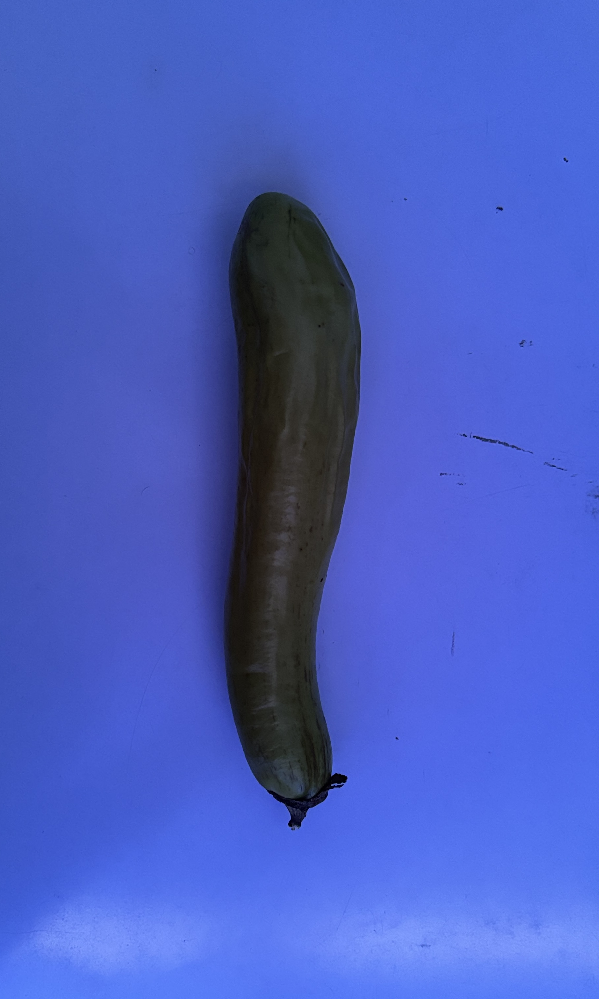

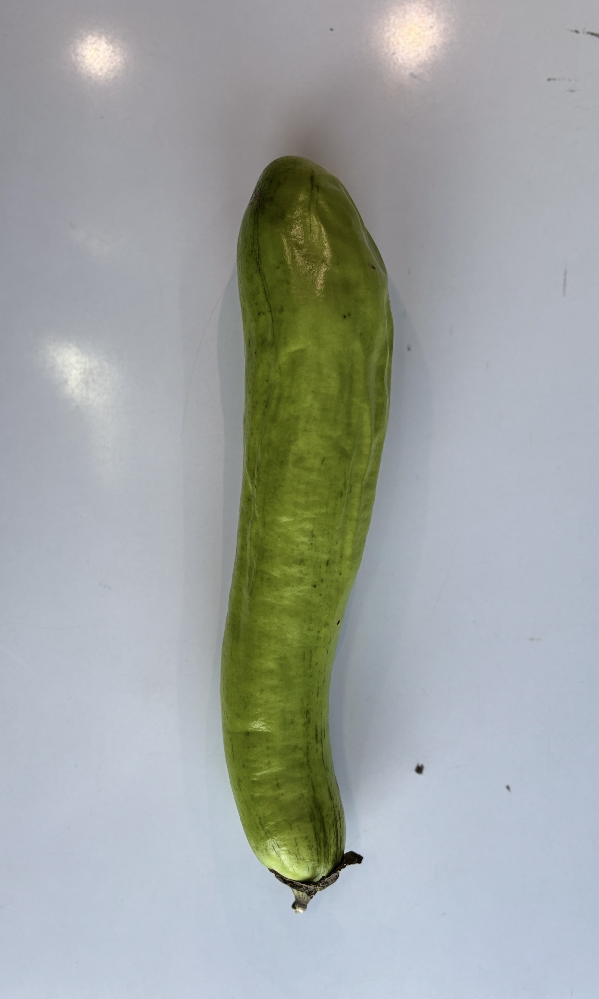

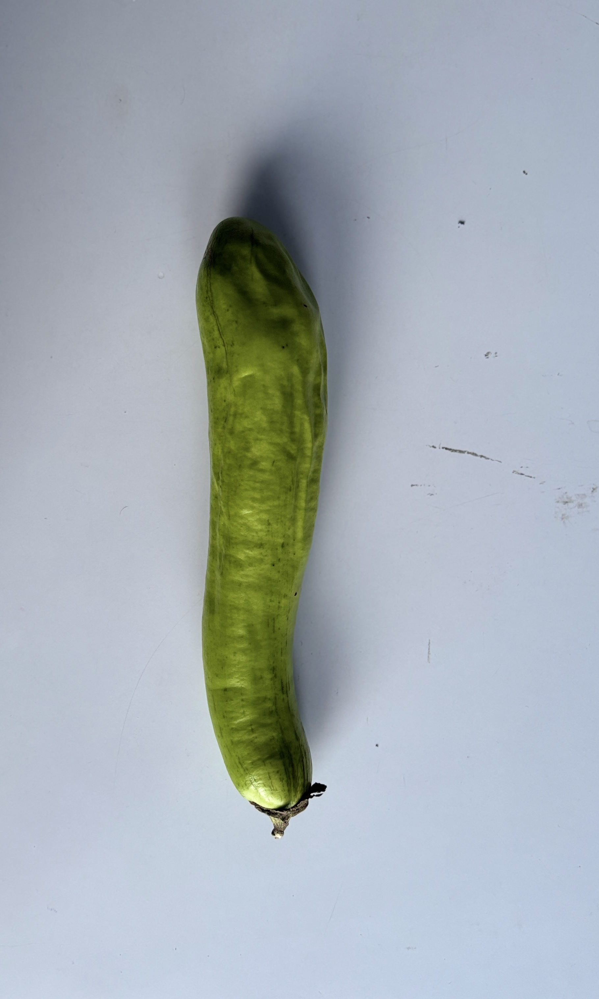

In [4]:
# Import library dan datanya

import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np
import math
import os
import glob

# pengambilan citra (sudah RGB)
terong_gelap = cv.imread('/content/drive/MyDrive/DataTerong/terong_gelap.JPG')
terong_terang = cv.imread('/content/drive/MyDrive/DataTerong/terong_terang.JPG')
terong_sebagian_bgr = cv.imread('/content/drive/MyDrive/DataTerong/terong_sebagian.JPG')

# ukuran citra
print('Ukuran citra')
print(terong_gelap.shape)
print(terong_terang.shape)
print(terong_sebagian_bgr.shape)

def crop_center(image, target_height, target_width):
    h, w = image.shape[:2]
    start_y = (h - target_height) // 2
    start_x = (w - target_width) // 2
    cropped = image[start_y:start_y + target_height, start_x:start_x + target_width]
    return cropped

# Target ukuran (dari terong_terang)
target_h, target_w = 3034, 1820

# Crop semua gambar
terong_gelap_resized = crop_center(terong_gelap, target_h, target_w)
terong_terang_resized = crop_center(terong_terang, target_h, target_w)
terong_sebagian_resized = crop_center(terong_sebagian_bgr, target_h, target_w)

# Tampilkan ukuran hasil crop
print('Ukuran hasil crop:')
print(terong_gelap_resized.shape)
print(terong_terang_resized.shape)
print(terong_sebagian_resized.shape)

cv2_imshow(terong_gelap_resized)
cv2_imshow(terong_terang_resized)
cv2_imshow(terong_sebagian_resized)

## Observasi dan Eksperimen Citra Gelap

### Menampilkan histogram citra gelap dan analisis distribusi intensitas

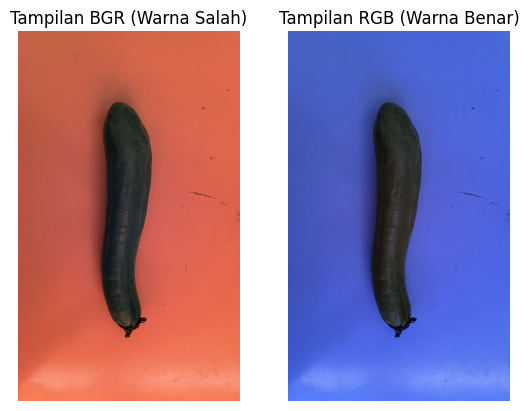

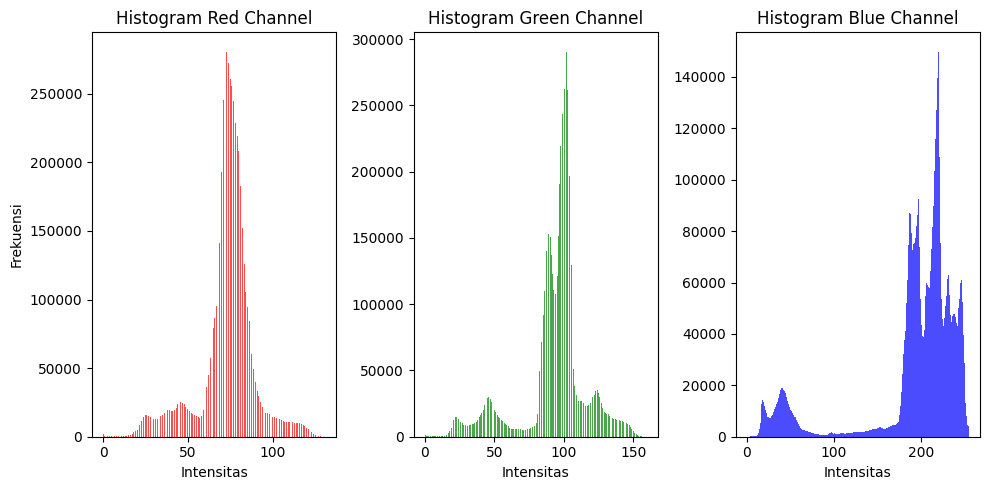

In [ ]:
# Menampilkan gambar BGR asli (warna akan aneh)
plt.subplot(1, 2, 1)
plt.imshow(terong_gelap_resized)
plt.title("Tampilan BGR (Warna Salah)")
plt.axis('off')

terong_gelap_rgb = cv.cvtColor(terong_gelap_resized, cv.COLOR_BGR2RGB)

# Menampilkan gambar setelah konversi ke RGB (warna akan benar)
plt.subplot(1, 2, 2)
plt.imshow(terong_gelap_rgb)
plt.title("Tampilan RGB (Warna Benar)")
plt.axis('off')

# terong_gelap_resized.jpg

R, G, B = cv.split(terong_gelap_rgb)

plt.figure(figsize=(10,5))

# Histogram tiap channel
plt.subplot(1,3,1)
plt.hist(R.ravel(), bins=256, color='red', alpha=0.7)
plt.title('Histogram Red Channel')
plt.xlabel('Intensitas')
plt.ylabel('Frekuensi')

plt.subplot(1,3,2)
plt.hist(G.ravel(), bins=256, color='green', alpha=0.7)
plt.title('Histogram Green Channel')
plt.xlabel('Intensitas')

plt.subplot(1,3,3)
plt.hist(B.ravel(), bins=256, color='blue', alpha=0.7)
plt.title('Histogram Blue Channel')
plt.xlabel('Intensitas')

plt.tight_layout()
plt.show()

* Analisis R Channel (Merah):
Penyebaran warna merah tidak merata. Hasil histogram warna merah terpusat di intensitas antara 50-100, menunjukkan bahwa tingkat kecerahan warna merah pada citra relatif rendah hingga sedang
* Analisis G Channel (Hijau):
Penyebaran warna hijau tidak merata dengan puncak intensitas di sekitar nilai 100. Hal ini menandakan bahwa warna hijau memiliki tingkat intensitas sedang dan berperan dalam menjaga keseimbangan warna citra.
* Analisis B Channel (Biru):
Penyebaran warna biru tidak merata dan cenderung condong ke kanan.

Dari visual histogram ini, dapat disimpulkan bahwa warna biru dominan di citra ini. Hal ini yang menyebabkan warna berwarna keunguan gelap. Padahal, terong yang digunakan adalah terong hijau.

### Menerapkan transformasi brightness dan contrast (linear/log brightness)

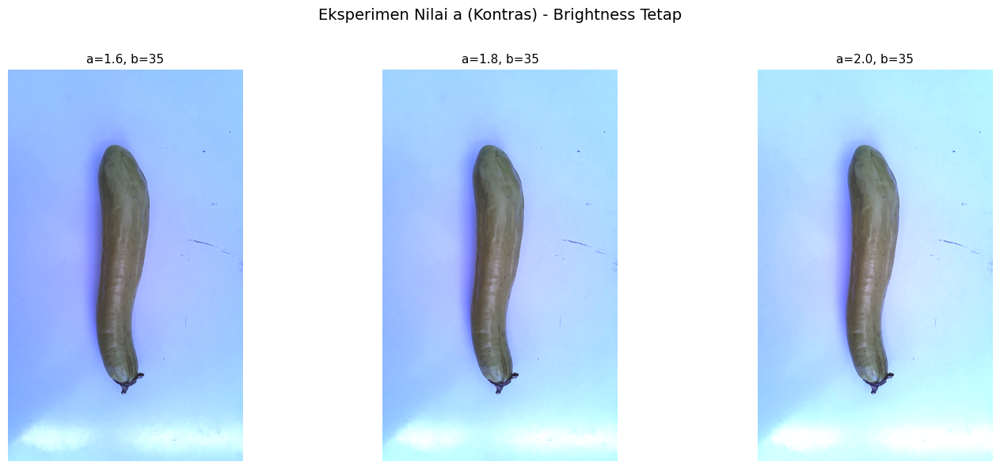

/tmp/ipython-input-299219770.py:50: UserWarning: tight_layout not applied: number of columns in subplot specifications must be multiples of one another.
  plt.tight_layout()


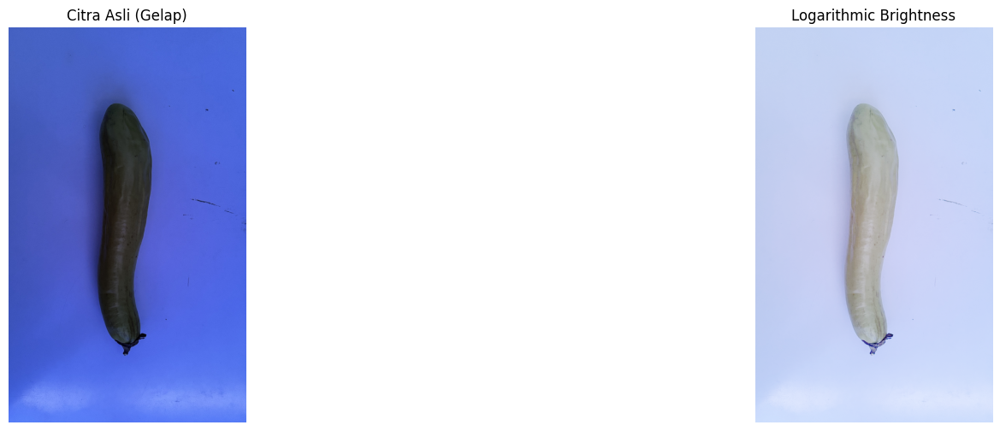

In [ ]:
# TRANSFORMASI LINEAR (BRIGHTNESS & CONTRAST)

a_values = np.arange(1.6, 2.1, 0.2)
b_value = 35  # brightness tetap

# ukuran figure besar agar proporsional seperti citra asli & log
plt.figure(figsize=(15, 6))

for i, a in enumerate(a_values, start=1):
    adjusted = cv.convertScaleAbs(terong_gelap_rgb, alpha=a, beta=b_value)
    ax = plt.subplot(1, len(a_values), i)
    ax.imshow(adjusted, aspect='equal')  # pertahankan proporsi citra
    ax.set_title(f"a={a:.1f}, b={b_value}", fontsize=11)
    ax.axis("off")

plt.suptitle("Eksperimen Nilai a (Kontras) - Brightness Tetap", fontsize=14, y=0.98)
plt.tight_layout()
plt.subplots_adjust(top=0.85)  # beri ruang untuk judul
plt.show()


# TRANSFORMASI LOGARITHMIC BRIGHTNESS

# menghitung konstanta c
c = 255 / np.log(1 + np.max(terong_gelap_rgb.astype(np.float32)))

# melakukan transformasi logarithmic
terong_gelap_log = c * np.log(1 + terong_gelap_rgb.astype(np.float32))

# melakukan normalisasi ke rentang 0-255
terong_gelap_log = cv.normalize(terong_gelap_log, None, 0, 255, cv.NORM_MINMAX)
terong_gelap_log = np.uint8(terong_gelap_log)

# Menampilkan gambar asli dan hasil transformasi

plt.figure(figsize=(18, 6))

# Citra asli
plt.subplot(1, 2, 1)
plt.imshow(terong_gelap_rgb)
plt.title("Citra Asli (Gelap)")
plt.axis("off")

# Citra hasil logarithmic brightness
plt.subplot(1, 3, 3)
plt.imshow(terong_gelap_log)
plt.title("Logarithmic Brightness")
plt.axis("off")

plt.tight_layout()
plt.show()

### Lakukan histogram equalization untuk memperbaiki sebaran kontras.
* Bandingkan hasil visual dan histogram sebelum–sesudah.
* Perhatikan apakah motif dan detail kain lebih terlihat jelas.
* Pastikan tekstur daun atau permukaan sayur menjadi lebih terlihat.


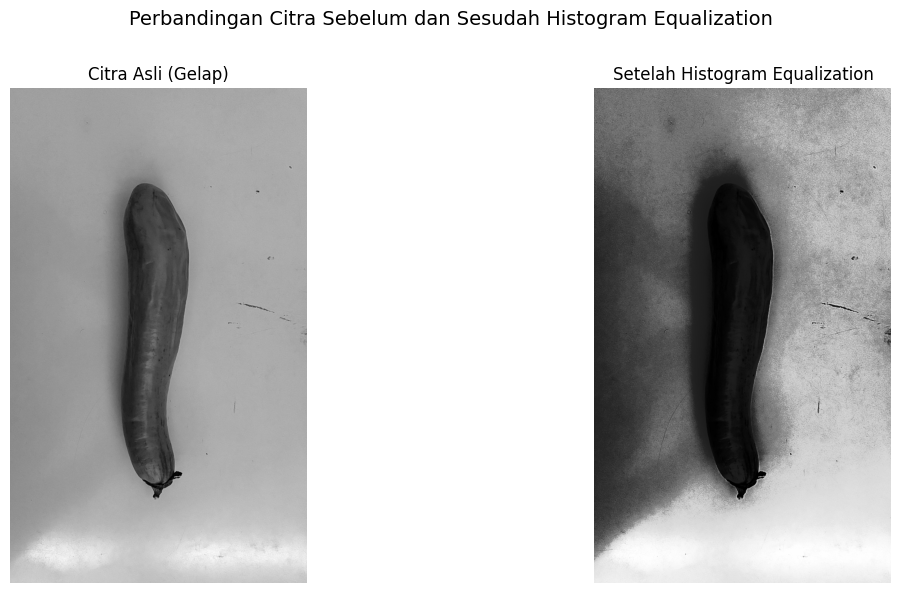

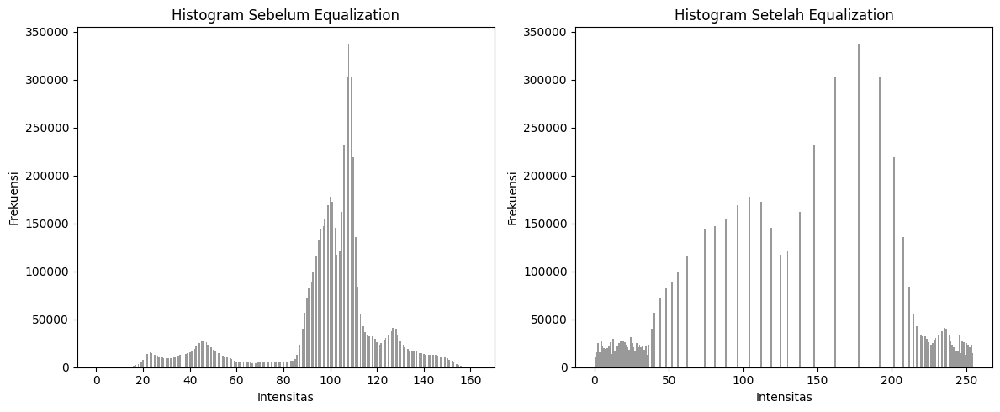

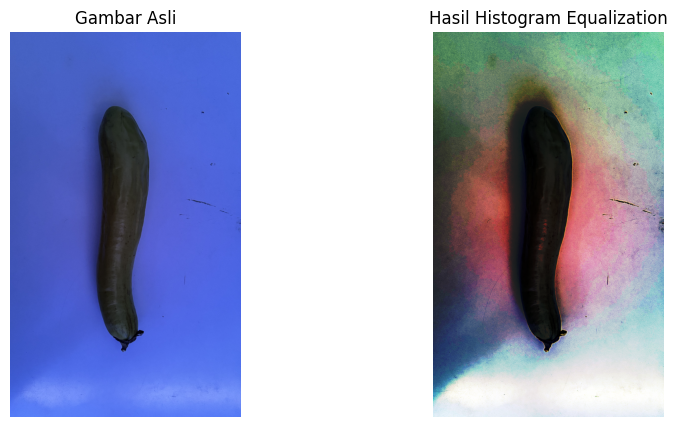

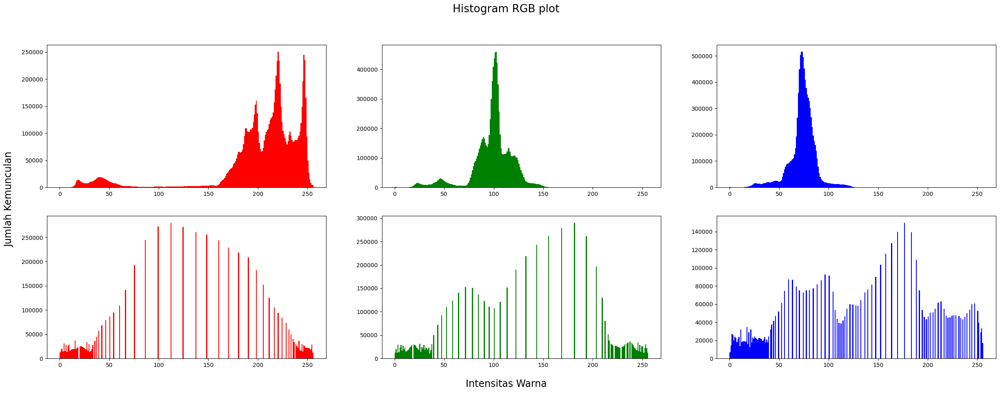

In [ ]:
terong_gelap_gray = cv.cvtColor(terong_gelap_rgb, cv.COLOR_RGB2GRAY)

terong_gelap_equalized = cv.equalizeHist(terong_gelap_gray)

# Visualisasi citra
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.imshow(terong_gelap_gray, cmap='gray')
plt.title("Citra Asli (Gelap)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(terong_gelap_equalized, cmap='gray')
plt.title("Setelah Histogram Equalization")
plt.axis("off")

plt.suptitle("Perbandingan Citra Sebelum dan Sesudah Histogram Equalization", fontsize=14)
plt.tight_layout()
plt.subplots_adjust(top=0.85)
plt.show()

# Visualisasi histogram
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(terong_gelap_gray.ravel(), bins=256, color='gray', alpha=0.8)
plt.title("Histogram Sebelum Equalization")
plt.xlabel("Intensitas")
plt.ylabel("Frekuensi")

plt.subplot(1, 2, 2)
plt.hist(terong_gelap_equalized.ravel(), bins=256, color='gray', alpha=0.8)
plt.title("Histogram Setelah Equalization")
plt.xlabel("Intensitas")
plt.ylabel("Frekuensi")

plt.tight_layout()
plt.show()

r, g, b = cv.split(terong_gelap_rgb)

r_equalized = cv.equalizeHist(r)
g_equalized = cv.equalizeHist(g)
b_equalized = cv.equalizeHist(b)

terong_gelap_eqz = cv.merge((r_equalized, g_equalized, b_equalized))

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(terong_gelap_rgb)
plt.title("Gambar Asli")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(terong_gelap_eqz)
plt.title("Hasil Histogram Equalization")
plt.axis('off')
plt.show()
print("")

# Buat figure baru untuk histogram
fig, axs = plt.subplots(2, 3, figsize=[30, 10])
fig.suptitle('Histogram RGB plot', fontsize=19)
fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical', fontsize=17)
fig.text(0.5, 0.04, 'Intensitas Warna', ha='center', fontsize=17)

# --- Histogram Asli (Baris Atas) ---
r_asli, g_asli, b_asli = cv.split(terong_gelap)
axs[0, 0].hist(r_asli.ravel(), 256, range=[0,256], color='red')
axs[0, 1].hist(g_asli.ravel(), 256, range=[0,256], color='green')
axs[0, 2].hist(b_asli.ravel(), 256, range=[0,256], color='blue')

# --- Histogram Hasil Equalization (Baris Bawah) ---
r_eq, g_eq, b_eq = cv.split(terong_gelap_eqz)
axs[1, 0].hist(r_eq.ravel(), 256, range=[0,256], color='red')
axs[1, 1].hist(g_eq.ravel(), 256, range=[0,256], color='green')
axs[1, 2].hist(b_eq.ravel(), 256, range=[0,256], color='blue')

plt.show()


Setelah dilakukan histogram equalization, citra hasi equalization memiliki hasil yang sangat jauh dari citra asli. Warna terong menjadi hitam dan tekstur dari terong tidak terlihat sama sekali.

### Menerapkan filter spesial

* Low-pass filter untuk menghaluskan noise atau tekstur berlebih pada
permukaan kain, untuk menghaluskan noise pada permukaan atau bayangan di sekitar sayur.
* High-pass atau Laplacian filter untuk menajamkan tepi motif batik atau
untuk menajamkan tepi daun, batang, atau detail tekstur pada sayur.


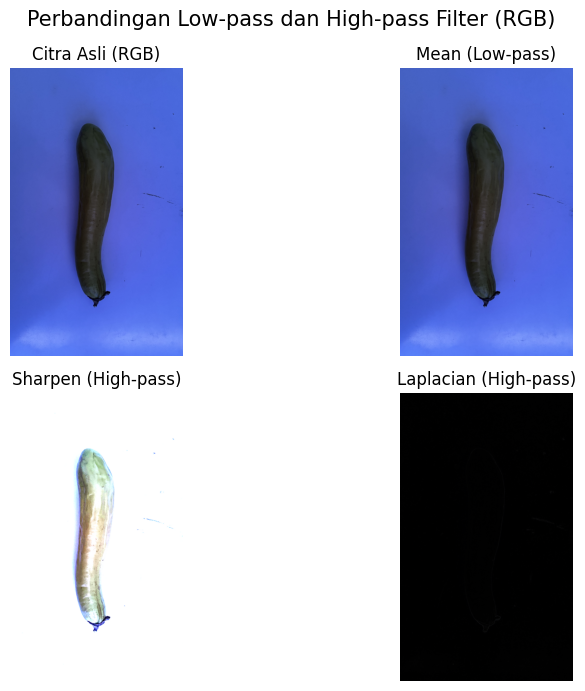

In [ ]:
# Low-pass filter
kernel_mean = np.ones((3,3), np.float32) / 9

# High-pass filter
kernel_sharpen = np.array([[0, -1, 0],
                           [-1, 9, -1],
                           [0, -1, 0]], np.float32)
kernel_laplacian = np.array([[0, -1, 0],
                             [-1, 4, -1],
                             [0, -1, 0]], np.float32)

# Daftar filter yang akan digunakan
filters = {
    "Mean (Low-pass)": kernel_mean,
    "Sharpen (High-pass)": kernel_sharpen,
    "Laplacian (High-pass)": kernel_laplacian,
}

# --- Melakukan konvolusi pada citra RGB ---
results = {}
for name, k in filters.items():
    result = cv.filter2D(terong_gelap_rgb, ddepth=-1, kernel=k)
    result = np.clip(result, 0, 255).astype(np.uint8)
    results[name] = result

# --- Visualisasi hasil ---
plt.figure(figsize=(10, 7))
plt.subplot(2, 2, 1)
plt.imshow(terong_gelap_rgb)  # sudah RGB, tidak perlu dikonversi lagi
plt.title("Citra Asli (RGB)")
plt.axis("off")

for i, (name, img) in enumerate(results.items(), start=2):
    plt.subplot(2, 2, i)
    plt.imshow(img)  # hasil filter juga sudah RGB
    plt.title(name)
    plt.axis("off")

plt.suptitle("Perbandingan Low-pass dan High-pass Filter (RGB)", fontsize=15)
plt.tight_layout()
plt.show()


### Floyd–Steinberg Dithering

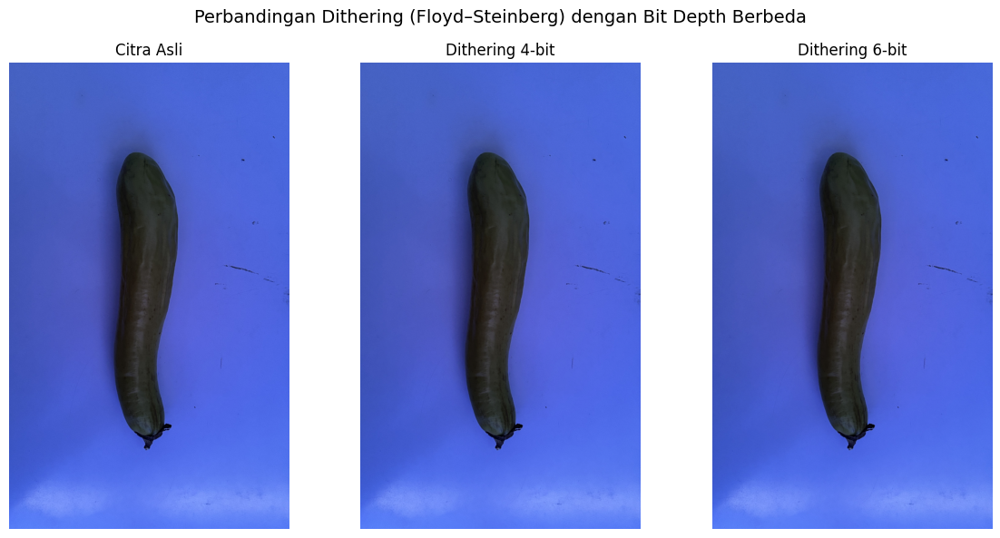

In [ ]:
# Floyd-Steinberg Dithering
import numpy as np
import matplotlib.pyplot as plt

# --- Floyd–Steinberg Dithering ---
def floyd_steinberg_dithering(image, bit_depth):
    image = image.astype(np.float32) / 255.0  # normalisasi ke rentang [0,1]
    h, w, c = image.shape
    output = image.copy()  # ✅ pakai tanda kurung
    levels = 2 ** bit_depth
    step = 1.0 / (levels - 1)

    for y in range(h - 1):
        for x in range(1, w - 1):
            for ch in range(c):  # dithering dilakukan per channel warna
                old_pixel = output[y, x, ch]
                new_pixel = np.round(old_pixel / step) * step
                output[y, x, ch] = new_pixel
                error = old_pixel - new_pixel

                # Sebarkan error ke piksel tetangga
                output[y, x + 1, ch] += error * (7 / 16)
                output[y + 1, x - 1, ch] += error * (3 / 16)
                output[y + 1, x, ch] += error * (5 / 16)
                output[y + 1, x + 1, ch] += error * (1 / 16)

    output = np.clip(output, 0, 1)
    return (output * 255).astype(np.uint8)

# --- Contoh penggunaan ---
dither_4bit = floyd_steinberg_dithering(terong_gelap_rgb, bit_depth=4)
dither_6bit = floyd_steinberg_dithering(terong_gelap_rgb, bit_depth=6)

# --- Visualisasi perbandingan ---
plt.figure(figsize=(12, 6))
plt.subplots_adjust(wspace=0.05)

titles = ['Citra Asli', 'Dithering 4-bit', 'Dithering 6-bit']
images = [terong_gelap_rgb, dither_4bit, dither_6bit]

for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.imshow(images[i])
    plt.title(titles[i])
    plt.axis('off')

plt.suptitle("Perbandingan Dithering (Floyd–Steinberg) dengan Bit Depth Berbeda", fontsize=14)
plt.tight_layout()
plt.show()


## Observasi dan Eksperimen Citra Terang

### Menampilkan histogram citra terang dan analisis distribusi intensitas

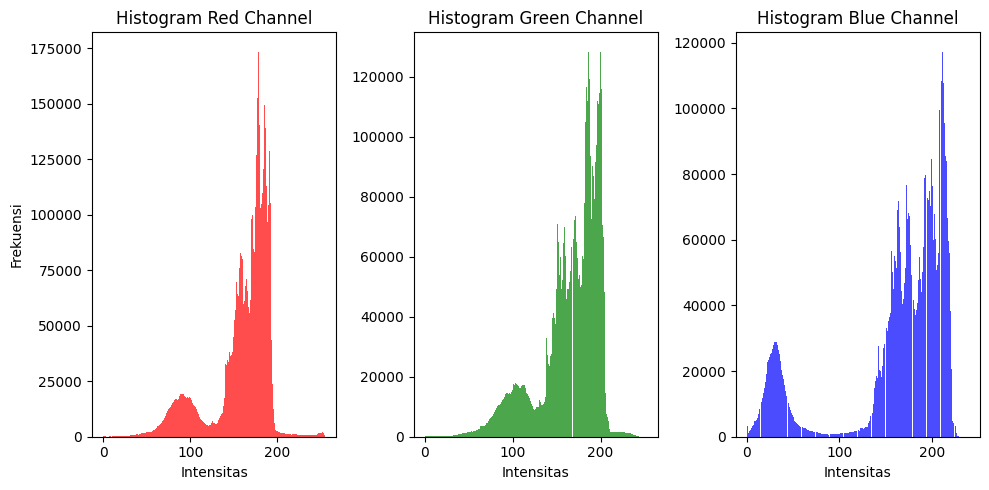

In [ ]:
#Konversi Citra BGR ke RGB
terong_terang_rgb = cv.cvtColor(terong_terang_resized, cv.COLOR_BGR2RGB)

#Memisahkan kanal warna menjadi individual R G B
R, G, B = cv.split(terong_terang_rgb)

#Membuat Figure
plt.figure(figsize=(10,5))

#Histogram Kanal Merah
plt.subplot(1,3,1)
plt.hist(R.ravel(), bins=256, color='red', alpha=0.7)
plt.title('Histogram Red Channel')
plt.xlabel('Intensitas')
plt.ylabel('Frekuensi')

#Histogram Kanal Hijau
plt.subplot(1,3,2)
plt.hist(G.ravel(), bins=256, color='green', alpha=0.7)
plt.title('Histogram Green Channel')
plt.xlabel('Intensitas')

#Histogram Kanal Biru
plt.subplot(1,3,3)
plt.hist(B.ravel(), bins=256, color='blue', alpha=0.7)
plt.title('Histogram Blue Channel')
plt.xlabel('Intensitas')

#Menampilkan Hasil
plt.tight_layout()
plt.show()

* Analisis R Channel (Merah):
Pada gambar di atas kita bisa melihat penyebaran warna merah terpusat pada 140 - 190 dan sebaran kontras cukup sempit yang mengartikan kontras cukup rendah.
* Analisis G Channel (Hijau):
Pada gambar di atas kita bisa melihat penyebaran warna hijau terpusat pada 130 - 200 dan sebaran kontras cukup sempit yang mengartikan kontras cukup rendah.
* Analisis B Channel (Biru):
Pada gambar di atas kita bisa melihat penyebaran warna biru terpusat pada 180 - 250 dan histogram lebih condong ke kanan yang mengartikan citra terang dan sebaran kontras cukup sempit yang mengartikan kontras cukup rendah.

### Menerapkan transformasi brightness dan contrast (linear/log brightness)

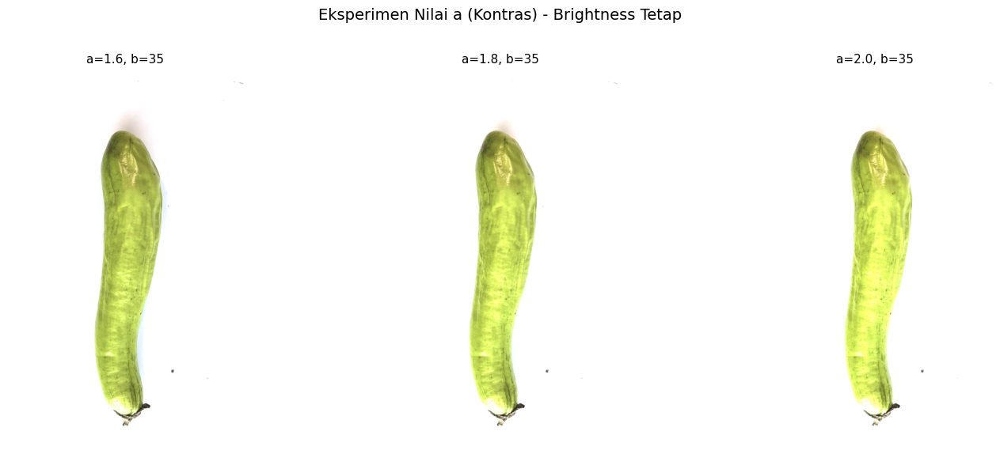

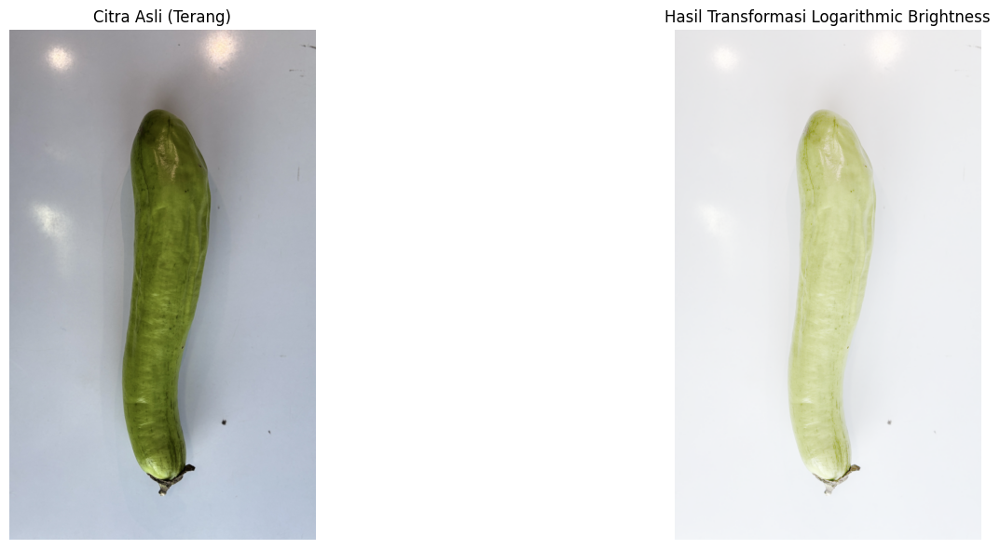

In [ ]:
#Inisiasi Nilai Kontras (a) dan Kecerahan (b)
a_values = np.arange(1.6, 2.1, 0.2)
b_value = 35

#Konversi Citra BGR ke RGB
terong_terang_rgb = cv.cvtColor(terong_terang_resized, cv.COLOR_BGR2RGB)

#Membuat Figure
plt.figure(figsize=(15, 6))

#Perulangan Mencoba Semua Nilai Kontras
for i, a in enumerate(a_values, start=1):

    img_bc = cv.convertScaleAbs(terong_terang_rgb, alpha=a, beta=b_value)

    #Menampilkan Hasil
    ax = plt.subplot(1, len(a_values), i)
    ax.imshow(img_bc, aspect='equal')
    ax.set_title(f"a={a:.1f}, b={b_value}", fontsize=11)
    ax.axis("off")

plt.suptitle("Eksperimen Nilai a (Kontras) - Brightness Tetap", fontsize=14, y=0.98)
plt.tight_layout()
plt.subplots_adjust(top=0.85)
plt.show()

#Mengubah tipe data citra ke Float
img_float = terong_terang_rgb.astype(np.float32)

#Perhitungan Logarithmic Brightness
c = 255 / np.log(1 + np.max(img_float))

img_log = c * np.log(1 + img_float)

img_log = cv.normalize(img_log, None, 0, 255, cv.NORM_MINMAX)
img_log = np.uint8(img_log)

#Membuat Figure
plt.figure(figsize=(18, 6))

#Menampilkan Hasil
plt.subplot(1, 2, 1)
plt.imshow(terong_terang_rgb)
plt.title("Citra Asli (Terang)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_log)
plt.title("Hasil Transformasi Logarithmic Brightness")
plt.axis("off")

plt.tight_layout()
plt.show()

dari percobaan di atas yang bisa kita amati, transformasi brightness dan contrast yang paling mendekati citra asli ada a (contrast) b (brightness) a = 1.6 b = 35

### Lakukan histogram equalization untuk memperbaiki sebaran kontras.
* Bandingkan hasil visual dan histogram sebelum–sesudah.
* Perhatikan apakah motif dan detail kain lebih terlihat jelas.
* Pastikan tekstur daun atau permukaan sayur menjadi lebih terlihat.


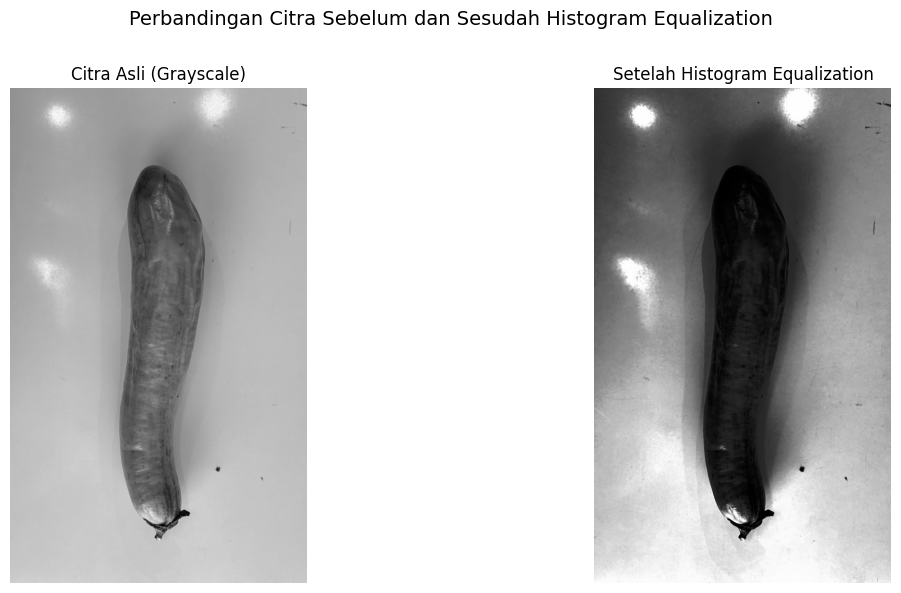

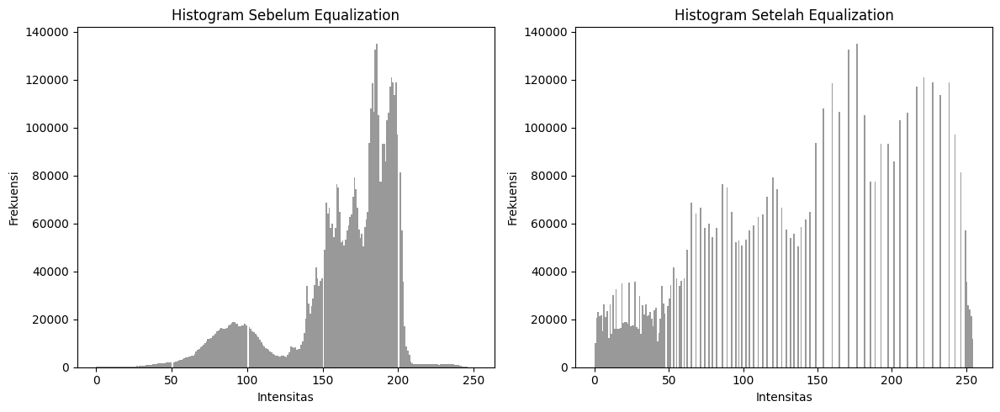

In [ ]:
#Konversi Citra BGR ke Grayscale
img_gray = cv.cvtColor(terong_terang_resized, cv.COLOR_BGR2GRAY)

#Proses Histogram Equalization
img_he = cv.equalizeHist(img_gray)

#Membuat Figure untuk Citra
plt.figure(figsize=(14, 6))

#Menampilkan Hasil
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap='gray')
plt.title("Citra Asli (Grayscale)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_he, cmap='gray')
plt.title("Setelah Histogram Equalization")
plt.axis("off")

plt.suptitle("Perbandingan Citra Sebelum dan Sesudah Histogram Equalization", fontsize=14)
plt.tight_layout()
plt.subplots_adjust(top=0.85)
plt.show()

#Membuat Figure untuk Histogram
plt.figure(figsize=(12, 5))

#Menampilkan Hasil
plt.subplot(1, 2, 1)
plt.hist(img_gray.ravel(), bins=256, color='gray', alpha=0.8)
plt.title("Histogram Sebelum Equalization")
plt.xlabel("Intensitas")
plt.ylabel("Frekuensi")

plt.subplot(1, 2, 2)
plt.hist(img_he.ravel(), bins=256, color='gray', alpha=0.8)
plt.title("Histogram Setelah Equalization")
plt.xlabel("Intensitas")
plt.ylabel("Frekuensi")

plt.tight_layout()
plt.show()

setelah citra dilakukan histogram equalization, citra jadi tampak berbayang dan warna terong menjadi sangat hitam dan menurut saya histogram equalization tidak selalu memperbaiki citra dari gambar di atas kita bisa melihat terong kehilangan detailnya dan gambar jadi berbayang maka dari itu saya bisa simpulkan bahwa histogram equalization tidak selalu memperbaiki citra

### Menerapkan filter Spatial

* Low-pass filter untuk menghaluskan noise atau tekstur berlebih pada
permukaan kain, untuk menghaluskan noise pada permukaan atau bayangan di sekitar sayur.
* High-pass atau Laplacian filter untuk menajamkan tepi motif batik atau
untuk menajamkan tepi daun, batang, atau detail tekstur pada sayur.


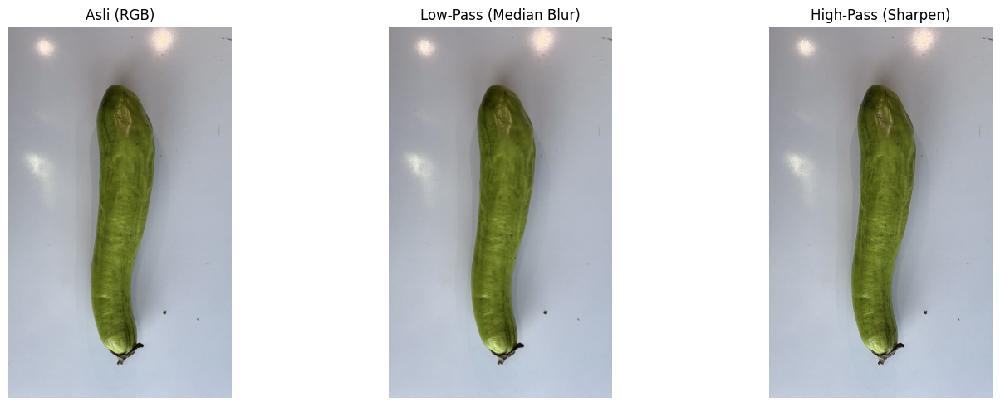

In [ ]:
# Konversi Citra dari BGR ke RGB
terong_terang = cv.cvtColor(terong_terang_resized, cv.COLOR_BGR2RGB)

# Low-Pass Filter (Gaussian Blur)
img_med = cv.medianBlur(terong_terang_rgb, 5)

# High-Pass Filter (Sharpen)
kernel_sharpen = np.array([
    [-1, -1, -1],
    [-1,  9, -1],
    [-1, -1, -1]
])
img_sharpen = cv.filter2D(terong_terang_rgb, -1, kernel_sharpen)

# Membuat Figure
plt.figure(figsize=(15, 5))

# Menampilkan Hasil
plt.subplot(1, 3, 1)
plt.imshow(terong_terang_rgb)
plt.title("Asli (RGB)")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(img_med)
plt.title("Low-Pass (Median Blur)")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(img_sharpen)
plt.title("High-Pass (Sharpen)")
plt.axis('off')

plt.tight_layout()
plt.show()

pada percobaan di atas filter spatial high pass (sharpening) merupakan paling cocok untuk citra terong kita dikarenakan pada filter tersebut menambah detail pada tekstur terong seperti kerutan pada terong

### Floyd–Steinberg Dithering

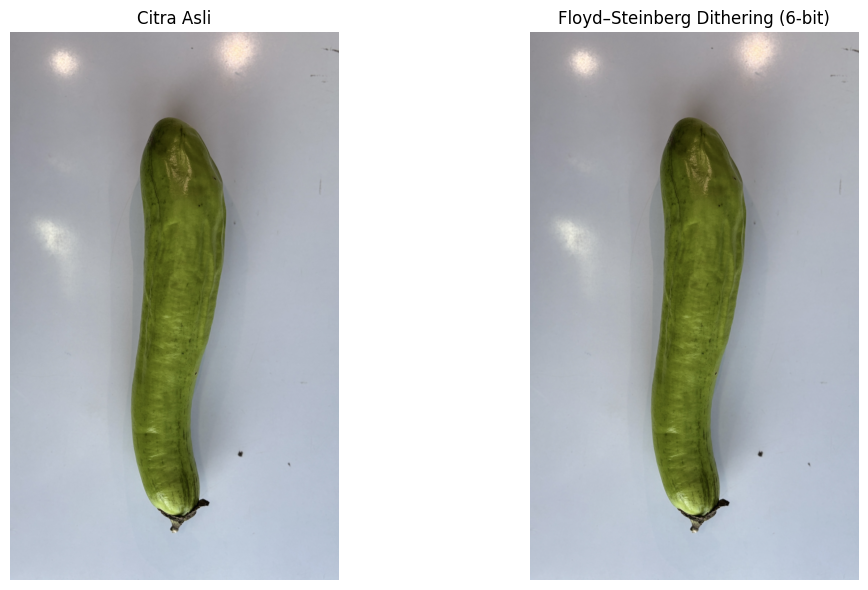

In [ ]:
#Konversi Citra BGR ke RGB
img_rgb = cv.cvtColor(terong_terang_resized, cv.COLOR_BGR2RGB)
#Mengubah tipe data citra ke float
img_float = img_rgb.astype(np.float32) / 255.0

#Menentukan Bit Depth yang ingin dipakai
bit_depth = 6
levels = 2 ** bit_depth
step = 1.0 / (levels - 1)

#Proses Floyd–Steinberg Dithering
dithered = img_float.copy()
height, width, channels = dithered.shape

#perulangan menyebarkan error ke piksel tetangga
for y in range(height - 1):
    for x in range(1, width - 1):
        for c in range(channels):
            old_pixel = dithered[y, x, c]
            new_pixel = np.round(old_pixel / step) * step
            dithered[y, x, c] = new_pixel
            error = old_pixel - new_pixel

            dithered[y, x+1, c] += error * 7/16
            dithered[y+1, x-1, c] += error * 3/16
            dithered[y+1, x, c] += error * 5/16
            dithered[y+1, x+1, c] += error * 1/16

dithered = np.clip(dithered, 0, 1)
dithered_uint8 = (dithered * 255).astype(np.uint8)

#Membuat Figure
plt.figure(figsize=(12,6))

#Menampilkan Hasil
plt.subplot(1,2,1)
plt.imshow(img_rgb)
plt.title('Citra Asli')
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(dithered_uint8)
plt.title(f'Floyd–Steinberg Dithering ({bit_depth}-bit)')
plt.axis('off')

plt.tight_layout()
plt.show()

setelah citra diproses Floyd–Steinberg Dithering dengan bit depth 6 bit citra menjadi lebih cerah tetapi tidak over exposure dan tetap mengikuti warna alam dan menajamkan detail dari terong tersebut

## Observasi dan Eksperimen Citra Terang Sebagian

1. Menampilkan histogram citra terang sebagian dan analisis distribusi intensitas

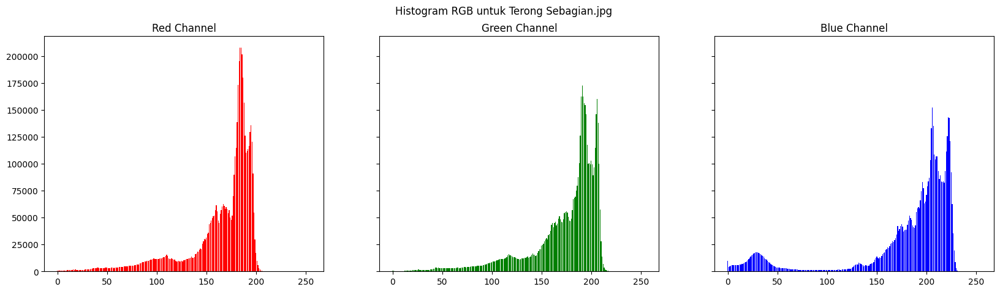

In [ ]:
terong_sebagian = cv.cvtColor(terong_sebagian_resized, cv.COLOR_BGR2RGB)

# Pisahkan channel R, G, B
r_channel = terong_sebagian[:,:,0]
g_channel = terong_sebagian[:,:,1]
b_channel = terong_sebagian[:,:,2]

# Hitung histogram untuk setiap channel menggunakan NumPy
hist_r, bins_r = np.histogram(r_channel.ravel(), bins=256, range=[0, 256])
hist_g, bins_g = np.histogram(g_channel.ravel(), bins=256, range=[0, 256])
hist_b, bins_b = np.histogram(b_channel.ravel(), bins=256, range=[0, 256])

# Plotting histogram
names = np.arange(256)
fig, axs = plt.subplots(1, 3, figsize=[20, 5], sharex=True, sharey=True)
fig.suptitle('Histogram RGB untuk Terong Sebagian.jpg')
axs[0].bar(names, hist_r, color='red')
axs[0].set_title('Red Channel')
axs[1].bar(names, hist_g, color='green')
axs[1].set_title('Green Channel')
axs[2].bar(names, hist_b, color='blue')
axs[2].set_title('Blue Channel')
plt.show()

* Analisis R Channel (Merah):
Penyebaran warna merah tidak merata. Hal ini dapat dilihat dari hasil histogram warna merah yang condong ke arah kanan. Sebagian besar piksel terkonsentrasi pada rentang intensitas 150 hingga 200.
* Analisis G Channel (Hijau):
Penyebaran warna hijau juga tidak merata. Distribusi piksel hijau juga terkonsentrasi di rentang intensitas tinggi, yaitu sekitar 150 hingga 220. Kurang lebih sama dengan channel merah.
* Analisis B Channel (Biru):
Penyebaran warna biru juga tidak merata. Terdapat puncak kecil di area gelap, sekitar intensitas 20-40. Ini menandakan adanya beberapa area bayangan atau bagian berwarna biru tua pada gambar. Namun, puncak utama dan tertinggi berada di rentang intensitas yang sangat tinggi, yaitu sekitar 180 hingga 240.

2. Terapkan transformasi brightness dan contrast (linear/log brightness).
    - Tentukan nilai b (brightness) dan a (contrast) yang sesuai agar data tampak natural seperti data asli.

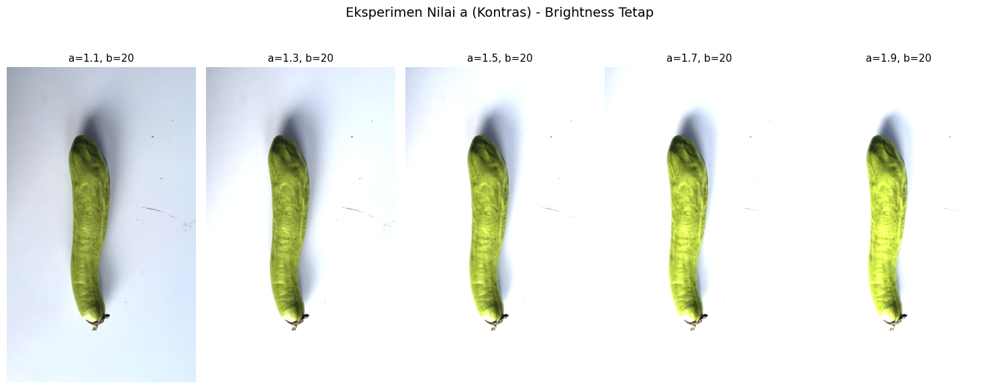

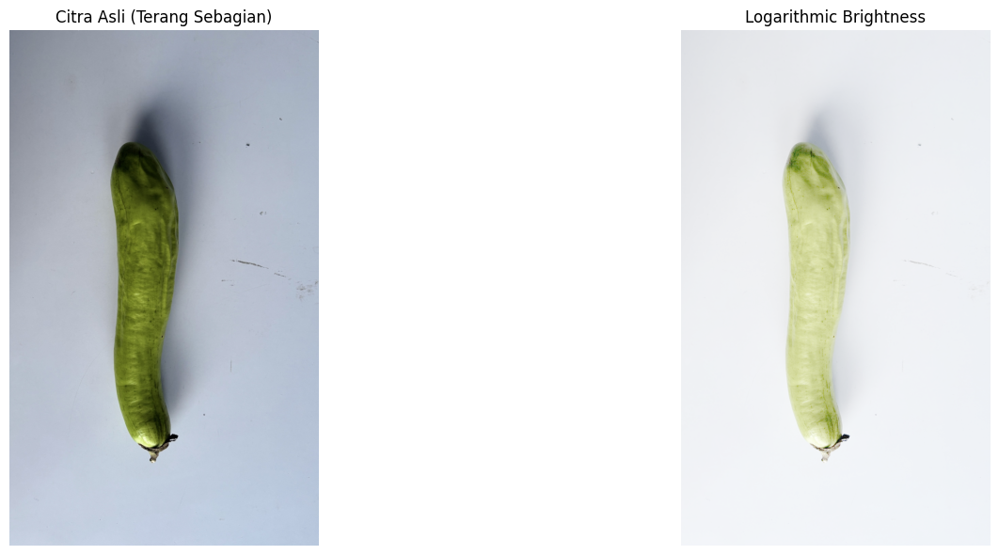

In [ ]:
# TRANSFORMASI LINEAR (BRIGHTNESS & CONTRAST)

a_values = np.arange(1.1, 2.1, 0.2)
b = 20  # brightness tetap

# ukuran figure besar agar proporsional seperti citra asli & log
plt.figure(figsize=(15, 6))

for i, a in enumerate(a_values, start=1):
    adjusted = cv.convertScaleAbs(terong_sebagian, alpha=a, beta=b)
    ax = plt.subplot(1, len(a_values), i)
    ax.imshow(adjusted, aspect='equal')  # pertahankan proporsi citra
    ax.set_title(f"a={a:.1f}, b={b}", fontsize=11)
    ax.axis("off")

plt.suptitle("Eksperimen Nilai a (Kontras) - Brightness Tetap", fontsize=14, y=0.98)
plt.tight_layout()
plt.subplots_adjust(top=0.85)
plt.show()

# TRANSFORMASI LOGARITHMIC BRIGHTNESS

# menghitung konstanta c
c = 255 / np.log(1 + np.max(terong_sebagian.astype(np.float32)))

# melakukan transformasi logarithmic
terong_sebagian_log = c * np.log(1 + terong_sebagian.astype(np.float32))

# melakukan normalisasi ke rentang 0-255
terong_sebagian_log = cv.normalize(terong_sebagian_log, None, 0, 255, cv.NORM_MINMAX)
terong_sebagian_log = np.uint8(terong_sebagian_log)

# Menampilkan gambar asli dan hasil transformasi

plt.figure(figsize=(18, 6))

# Citra asli (terong sebagian)
plt.subplot(1, 2, 1)
plt.imshow(terong_sebagian)
plt.title("Citra Asli (Terang Sebagian)")
plt.axis("off")

# Citra hasil logarithmic brightness
plt.subplot(1, 2, 2)
plt.imshow(terong_sebagian_log)
plt.title("Logarithmic Brightness")
plt.axis("off")

plt.tight_layout()
plt.show()

Dari hasil eksperimen di atas, menurut saya nilai b (brightness) dan a (contrast) yang sesuai agar data tampak natural seperti data asli adalah a=1.3 dan b=20.

3. Lakukan histogram equalization untuk memperbaiki sebaran kontras.
    - Bandingkan hasil visual dan histogram sebelum-sesudah.
    - Perhatikan apakah motif dan detail kain lebih terlihat jelas.
    - Pastikan tekstur daun atau permukaan sayur menjadi lebih terlihat.

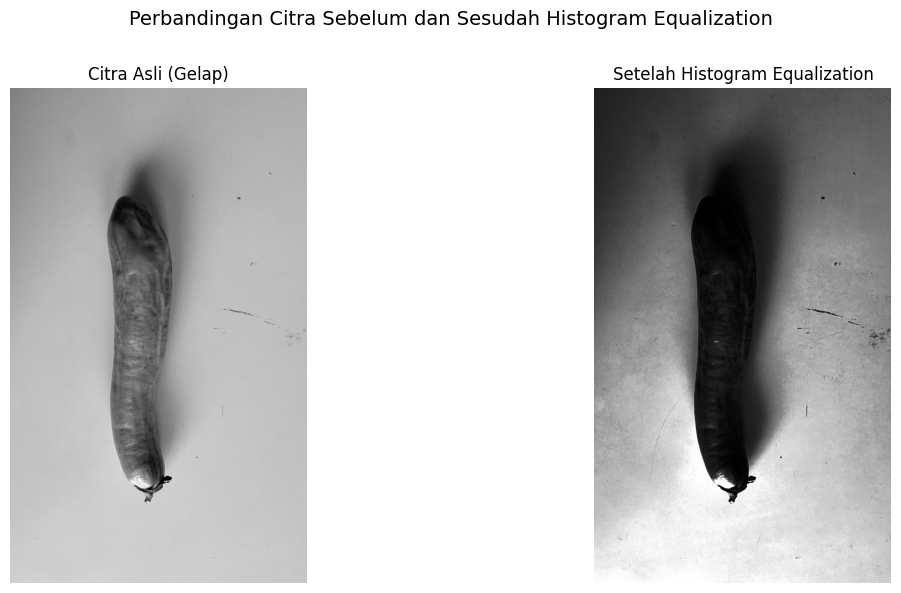

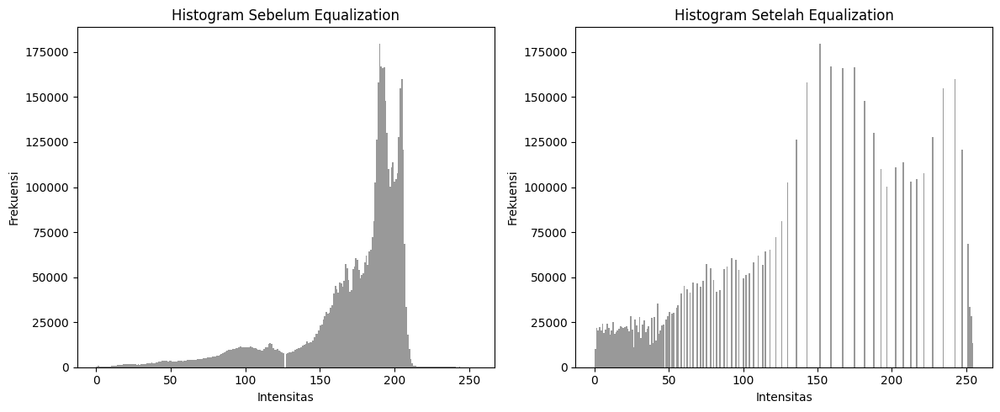

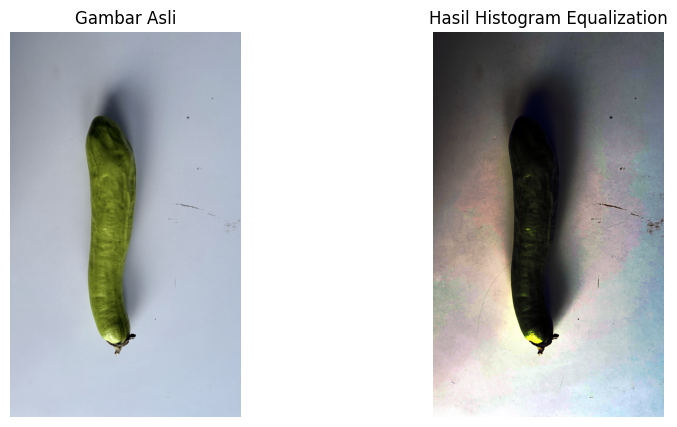

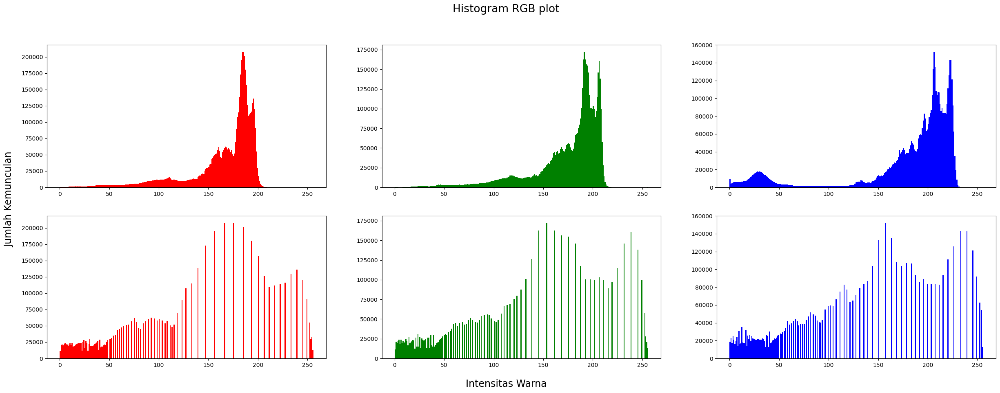

In [ ]:
terong_sebagian_gray = cv.cvtColor(terong_sebagian, cv.COLOR_RGB2GRAY)

terong_sebagian_equalized = cv.equalizeHist(terong_sebagian_gray)

# Visualisasi citra
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.imshow(terong_sebagian_gray, cmap='gray')
plt.title("Citra Asli (Gelap)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(terong_sebagian_equalized, cmap='gray')
plt.title("Setelah Histogram Equalization")
plt.axis("off")

plt.suptitle("Perbandingan Citra Sebelum dan Sesudah Histogram Equalization", fontsize=14)
plt.tight_layout()
plt.subplots_adjust(top=0.85)
plt.show()

# Visualisasi histogram
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(terong_sebagian_gray.ravel(), bins=256, color='gray', alpha=0.8)
plt.title("Histogram Sebelum Equalization")
plt.xlabel("Intensitas")
plt.ylabel("Frekuensi")

plt.subplot(1, 2, 2)
plt.hist(terong_sebagian_equalized.ravel(), bins=256, color='gray', alpha=0.8)
plt.title("Histogram Setelah Equalization")
plt.xlabel("Intensitas")
plt.ylabel("Frekuensi")

plt.tight_layout()
plt.show()
print("")

r, g, b = cv.split(terong_sebagian)

r_equalized = cv.equalizeHist(r)
g_equalized = cv.equalizeHist(g)
b_equalized = cv.equalizeHist(b)

terong_sebagian_eqz = cv.merge((r_equalized, g_equalized, b_equalized))

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(terong_sebagian)
plt.title("Gambar Asli")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(terong_sebagian_eqz)
plt.title("Hasil Histogram Equalization")
plt.axis('off')
plt.show()

# Buat figure baru untuk histogram
fig, axs = plt.subplots(2, 3, figsize=[30, 10])
fig.suptitle('Histogram RGB plot', fontsize=19)
fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical', fontsize=17)
fig.text(0.5, 0.04, 'Intensitas Warna', ha='center', fontsize=17)

# --- Histogram Asli (Baris Atas) ---
r_asli, g_asli, b_asli = cv.split(terong_sebagian)
axs[0, 0].hist(r_asli.ravel(), 256, range=[0,256], color='red')
axs[0, 1].hist(g_asli.ravel(), 256, range=[0,256], color='green')
axs[0, 2].hist(b_asli.ravel(), 256, range=[0,256], color='blue')

# --- Histogram Hasil Equalization (Baris Bawah) ---
r_eq, g_eq, b_eq = cv.split(terong_sebagian_eqz)
axs[1, 0].hist(r_eq.ravel(), 256, range=[0,256], color='red')
axs[1, 1].hist(g_eq.ravel(), 256, range=[0,256], color='green')
axs[1, 2].hist(b_eq.ravel(), 256, range=[0,256], color='blue')

plt.show()

Hasil dari HE memang menunjukkan penyebaran intensitas pixel yang lebih merata, namun secara visual citra terlihat menjadi lebih gelap karena memang intensitas 0-50 lumayan padat. Warna terong menjadi sangat hitam sehingga detailnya malah tidak kelihatan. Jadi, histogram equalization tidak selalu memperbaiki citra.

4. Terapkan filter spasial:
    - Low-pass filter untuk menghaluskan noise atau tekstur berlebih pada permukaan kain, untuk menghaluskan noise pada permukaan atau bayangan di sekitar sayur.
    - High-pass atau Laplacian filter untuk menajamkan tepi motif batik atau untuk menajamkan tepi daun, batang, atau detail tekstur pada sayur.

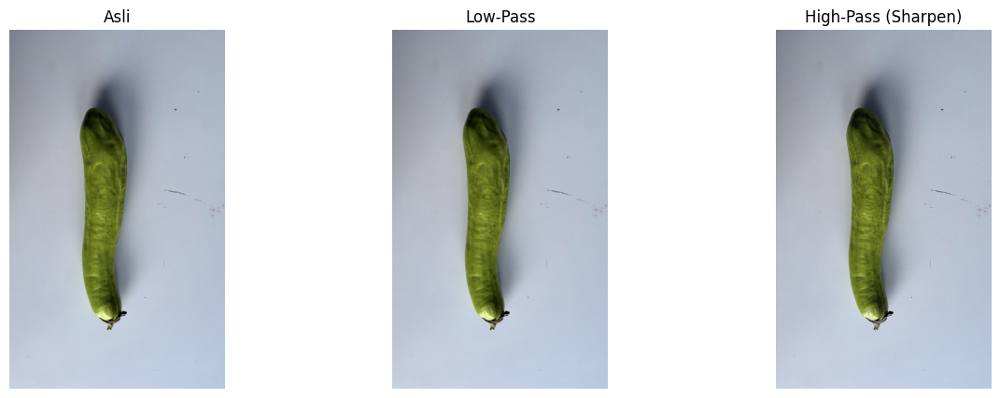

In [ ]:
# Gunakan gambar yang pencahayaannya paling baik ('terong_sebagian')
target_image_rgb = terong_sebagian

# a. Low-Pass Filter untuk menghaluskan
kernel_low_pass = np.array([
    [1, 1, 1],
    [1, 4, 1],
    [1, 1, 1]
]) / 12.0
img_low_pass = cv.filter2D(target_image_rgb, -1, kernel_low_pass)

# b. High-Pass Filter (Sharpen) untuk menajamkan
kernel_sharpen = np.array([[-1, -1, -1],
                            [-1,  9, -1],
                            [-1, -1, -1]])
img_sharpen = cv.filter2D(target_image_rgb, -1, kernel_sharpen)

# Tampilkan perbandingan
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(target_image_rgb)
plt.title("Asli")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(img_low_pass)
plt.title("Low-Pass")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(img_sharpen)
plt.title("High-Pass (Sharpen)")
plt.axis('off')

plt.show()

5. Implementasikan Floyd-Steinberg Dithering untuk menurunkan kedalaman warna sesuai data anda (bit-depth 4-6 bit), lalu analisis bagaimana efeknya terhadap kehalusan gradasi warna motif batik setelah reduksi warna dilakukan atau terhadap detail warna alami sayur

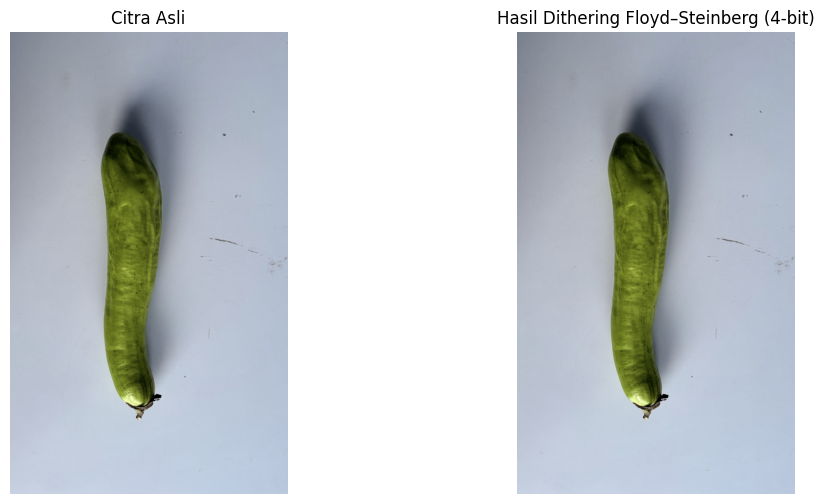

In [ ]:
h, w, c = terong_sebagian.shape
output = terong_sebagian.copy().astype(np.float32)

bit_depth = 4
levels = 2 ** bit_depth
jarakPixel = 255 / (levels - 1)

# Floyd–Steinberg Dithering untuk citra RGB
for y in range(h - 1):
    for x in range(1, w - 1):
        for ch in range(c):  # B, G, R
            old_pixel = output[y, x, ch]

            # Kuantisasi ke level terdekat
            new_pixel = np.round(old_pixel / jarakPixel) * jarakPixel
            output[y, x, ch] = new_pixel

            # Hitung error
            error = old_pixel - new_pixel

            # Sebarkan error sesuai Floyd–Steinberg kernel
            output[y, x+1, ch]   += error * 7/16
            output[y+1, x-1, ch] += error * 3/16
            output[y+1, x, ch]   += error * 5/16
            output[y+1, x+1, ch] += error * 1/16

# Clip agar tetap valid
output = np.clip(output, 0, 255).astype(np.uint8)

# Tampilkan hasil
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.title("Citra Asli")
plt.imshow(terong_sebagian)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title(f"Hasil Dithering Floyd–Steinberg ({bit_depth}-bit)")
plt.imshow(output)
plt.axis("off")
plt.show()

## Bagian B - Analisis
Jawablah dalam bentuk narasi atau tabel analisis singkat:
1. Bagaimana perubahan nilai brightness dan contrast memengaruhi hasil histogram
dari data gelap?


> Pada citra gelap ketika dilakukan perubahan nilai brightness dan contrast akan terjadi pergeseran dan penyebaran histogram, pada citra gelap pusat sebaran histogram condong ke kiri dan beberapa sebaran histogram citra gelap cukup sempit yang mengartikan kontras rendah, dan ketika dilakukan perubahan nilai brightness dan contrast maka histogram mengalami pergeseran ke kanan dan sebaran histogram tersebar rata yang menandakan citra mengalami perubahan nilai brightness dan contrast


2. Apakah histogram equalization selalu memperbaiki detail data? Jelaskan alasannya dengan contoh hasil Anda. <br>

> Tidak, histogram equalization tidak selalu memperbaiki detail data. Contohnya ada pada proses HE untuk data terong sebagian. Meskipun intensitas piksel lebih terdistribusi, terlihat citra terong malah menjadi lebih gelap sehingga detailnya hilang. Histogram Equalization tidak selalu memperbaiki detail data karena merupakan teknik global yang tidak mempertimbangkan konteks lokal dalam sebuah gambar. HE menerapkan satu fungsi transformasi yang sama ke seluruh piksel berdasarkan distribusi intensitas keseluruhan gambar. <br>
Citra terong memiliki area background putih yang luas, sehingga HE memperluas kontras di area tersebut sehingga pada bagian terong malah makin gelap dan kehilangan detail. Sebagian besar piksel pada citra terong sebagian adalah latar belakang putih sehingga menciptakan puncak yang sangat besar di sisi kanan histogram. Karena algoritma HE mencoba meratakan seluruh histogram, puncak besar dari latar belakang ini "mendominasi" perhitungan. Untuk memberi ruang pada rentang warna terang, algoritma "memaksa" rentang warna yang lebih sedikit (yaitu warna terong di area tengah) untuk dipadatkan ke area yang lebih sempit dan lebih gelap. Akibatnya, detail-detail halus pada permukaan terong yang tadinya merupakan variasi kecil di rentang abu-abu tengah menjadi terjepit ke dalam beberapa nilai gelap yang hampir sama. Meskipun kontras global (antara terong yang gelap dan latar belakang yang terang) meningkat, kontras lokal (antar bagian-bagian di permukaan terong itu sendiri) justru hilang.

3. Bandingkan hasil low-pass dan high-pass filter pada area data — bagian mana yang paling terpengaruh?


> Pada citra terang yang memakai Low-Pass (Median Blur) dan High Pass (Sharpen)
low pass menghasilkan citra yang lebih fokus terhadap warna terong membuat warna tersebut menjadi sedikit alami daripada citra aslinya, sedangkan high pass menajamkan citra dan membuat citra tampak lebih terang sedikit daripada citra asli menghasilkan citra lebih detail daripada low pass

> Pada citra terang sebagian yang memakai Low-Pass (Blur) dan High Pass (Sharpen),
low pass menghasilkan citra yang lebih fokus terhadap warna terong membuat warna tersebut menjadi sedikit alami citra aslinya, sedangkan high pass menajamkan citra dan membuat citra tampak lebih terang sedikit daripada citra asli menghasilkan citra lebih detail daripada low pass

> Pada citra gelap yang memakai Low-Pass (Mean) dan High Pass (Sharpen)
low pass menghasilkan citra yang lebih sedikit bayangan daripada citra aslinya dan detail terong sedikit membaik daripada citra aslinya, sedangkan high pass menajamkan detail citra tetapi membuat citra menjadi over exposure.

4. Mengapa proses dithering bisa mempertegas atau justru mengaburkan detail data? <br>

> Dithering memanipulasi persepsi visual dengan menyebarkan error. Dithering mempertegas karena menciptakan kontras tinggi pada tingkat piksel (hitam vs. putih) yang membentuk ilusi kontur. Oleh karena itu, bentuk dan lekukan utama terong menjadi sangat jelas. Namun dithering juga dapat mengaburkan detail data karena proses kuantisasi yang menghilangkan informasi warna dan gradasi yang halus sehingga tekstur bintik-bintik kecil atau perubahan warna yang lembut pada kulit terong hilang.

5. Berdasarkan hasil percobaan Anda, kombinasi teknik mana yang paling efektif untuk meningkatkan readability fitur data batik / data sayur sebelum tahap deteksi?

> Kombinasi teknik yang paling efektif untuk meningkatkan readability adalah transformasi brightness & contrast > high pass filter > dithering, 3 kombinasi tersebut sangat cocok untuk meningkatkan readability dikarenakan pada brightness dan contrast untuk meningkatkan kecerahan dan kontras citra dan setelah itu high pass filter menajamkan detail dari bentuk terong tersebut dan terakhir dithering untuk memanipulasi persepsi visual yang membuat terong nampak sangat jelas.

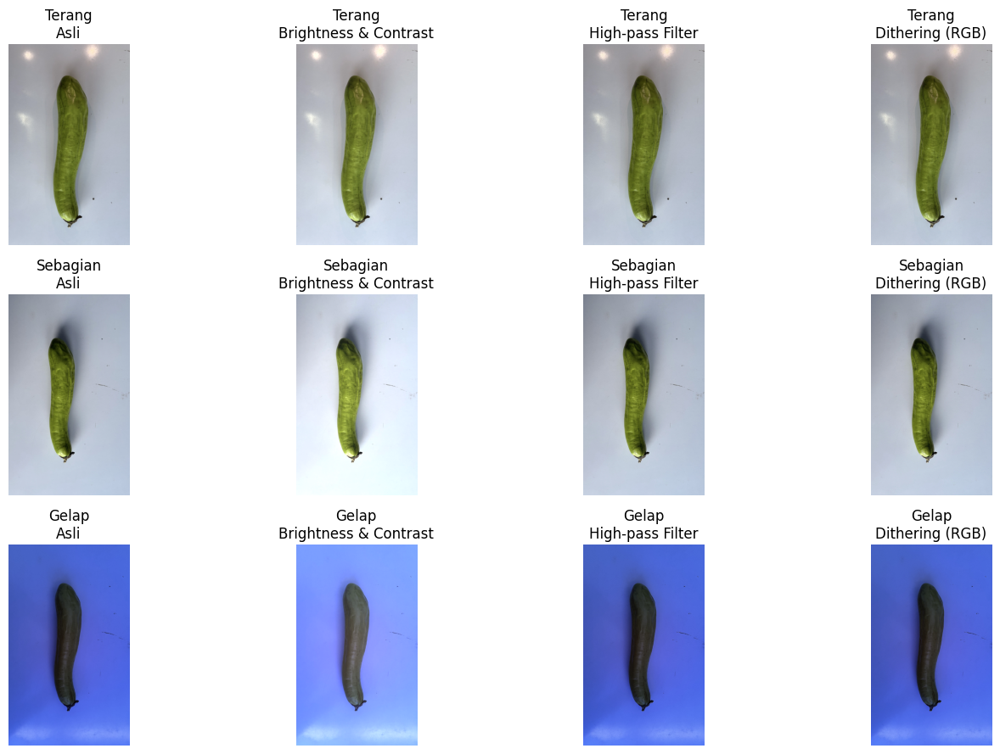

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === Konversi ke RGB ===
terong_terang = cv.cvtColor(terong_terang_resized, cv.COLOR_BGR2RGB)
terong_sebagian = cv.cvtColor(terong_sebagian_resized, cv.COLOR_BGR2RGB)
terong_gelap = cv.cvtColor(terong_gelap_resized, cv.COLOR_BGR2RGB)

# === Brightness & Contrast ===
def adjust_brightness_contrast(img, alpha, beta):
    return cv.convertScaleAbs(img, alpha=alpha, beta=beta)

terang_bc = adjust_brightness_contrast(terong_terang, 1.05, 10)
terang_sebagian_bc = adjust_brightness_contrast(terong_sebagian, 1.15, 20)
gelap_bc = adjust_brightness_contrast(terong_gelap, 1.25, 35)

# === High-pass Filter ===
kernel_hp = np.array([[-1, -1, -1],
                      [-1,  9.5, -1],
                      [-1, -1, -1]]) / 1.5

terang_hp = cv.filter2D(terong_terang, -1, kernel_hp)
terang_sebagian_hp = cv.filter2D(terong_sebagian, -1, kernel_hp)
gelap_hp = cv.filter2D(terong_gelap, -1, kernel_hp)

# === RGB Floyd–Steinberg Dithering ===
def floyd_steinberg_dithering_rgb(image):
    img = image.astype(np.float32) / 255.0
    h, w, c = img.shape
    for y in range(h - 1):
        for x in range(1, w - 1):
            old_pixel = img[y, x].copy()
            new_pixel = np.where(old_pixel > 0.5, 1.0, 0.0)
            img[y, x] = new_pixel
            error = old_pixel - new_pixel
            # Sebarkan error ke pixel sekitar (per kanal)
            img[y, x+1] += error * 7/16
            img[y+1, x-1] += error * 3/16
            img[y+1, x] += error * 5/16
            img[y+1, x+1] += error * 1/16
    return np.clip(img * 255, 0, 255).astype(np.uint8)

dithering_terang = floyd_steinberg_dithering_rgb(terang_hp)
dithering_terang_sebagian = floyd_steinberg_dithering_rgb(terang_sebagian_hp)
dithering_gelap = floyd_steinberg_dithering_rgb(gelap_hp)

# === Kumpulan hasil ===
images_terang = [terong_terang, terang_bc, terang_hp, dithering_terang]
images_sebagian = [terong_sebagian, terang_sebagian_bc, terang_sebagian_hp, dithering_terang_sebagian]
images_gelap = [terong_gelap, gelap_bc, gelap_hp, dithering_gelap]

titles = [
    "Asli",
    "Brightness & Contrast",
    "High-pass Filter",
    "Dithering (RGB)"
]

# === Visualisasi hasil ===
plt.figure(figsize=(15, 9))

# Tentukan jumlah kolom berdasarkan jumlah judul
num_columns = len(titles) # Ini akan menghasilkan nilai 4

# Baris 1: Citra Terang
for i in range(num_columns):
    plt.subplot(3, num_columns, i + 1)
    plt.imshow(images_terang[i])
    plt.title(f"Terang\n{titles[i]}")
    plt.axis('off')

# Baris 2: Citra Sebagian
for i in range(num_columns):
    plt.subplot(3, num_columns, i + 1 + num_columns) # Tambahkan offset
    plt.imshow(images_sebagian[i])
    plt.title(f"Sebagian\n{titles[i]}")
    plt.axis('off')

# Baris 3: Citra Gelap
for i in range(num_columns):
    plt.subplot(3, num_columns, i + 1 + (num_columns * 2)) # Tambahkan offset
    plt.imshow(images_gelap[i])
    plt.title(f"Gelap\n{titles[i]}")
    plt.axis('off')

plt.tight_layout()
plt.show()


## Bagian D - Analisis Akhir & Kesimpulan
Tuliskan 1 halaman analisis:
- Urutan proses terbaik untuk menghasilkan citra paling siap recognition
- Perbandingan nilai PSNR antara citra asli yang memiliki pencahanyaan baik dan hasil pra-pemrosesan
- Rekomendasi metode peningkatan kualitas data sesuai object untuk sistem
klasifikasi motif batik atau untuk sistem identifikasi jenis sayuran

**Urutan proses terbaik untuk menghasilkan citra paling siap untuk menghasilkan citra yang siap recognition**

=== SEMUA KOMBINASI DAN NILAI PSNR ===
                    Combination     PSNR
Asli + BC + HP + Dithering + HE 8.594013
Asli + HP + BC + Dithering + HE 8.587296
Asli + BC + Dithering + HP + HE 8.575712
Asli + BC + Dithering + HE + HP 8.575711
Asli + HE + HP + Dithering + BC 8.119386
Asli + HE + Dithering + HP + BC 8.112175
Asli + HP + HE + Dithering + BC 8.091703
Asli + HE + BC + HP + Dithering 7.922309
Asli + HE + BC + Dithering + HP 7.912199
Asli + HE + HP + BC + Dithering 7.902228
Asli + HP + HE + BC + Dithering 7.897254
Asli + HP + Dithering + HE + BC 7.832333
Asli + Dithering + HP + HE + BC 7.821827
Asli + Dithering + HE + HP + BC 7.818734
Asli + BC + HP + HE + Dithering 7.191692
Asli + BC + HE + Dithering + HP 7.138425
Asli + HP + BC + HE + Dithering 7.135629
Asli + BC + HE + HP + Dithering 7.093855
Asli + HP + Dithering + BC + HE 6.800468
Asli + Dithering + BC + HP + HE 6.790583
Asli + Dithering + HP + BC + HE 6.788885
Asli + Dithering + BC + HE + HP 6.787583
Asli + Dithering +

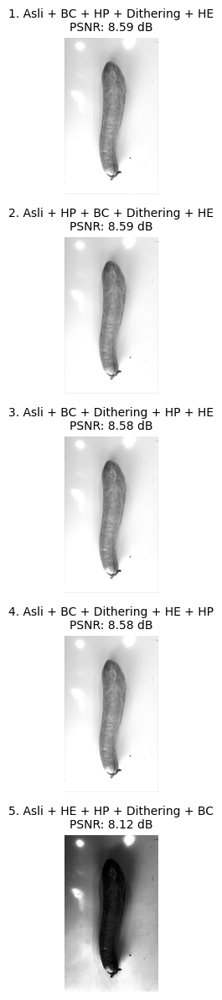

In [5]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import itertools
from skimage.metrics import peak_signal_noise_ratio as psnr

# === 1. BACA DAN KONVERSI CITRA ===
terong_terang = cv.cvtColor(terong_terang_resized, cv.COLOR_BGR2RGB)
gray = cv.cvtColor(terong_terang, cv.COLOR_RGB2GRAY)

# === 2. PARAMETER DASAR ===
b, a = 30, 1.2  # brightness & contrast

# === 3. DEFINISI TEKNIK PEMROSESAN ===
def apply_bc(img):
    return cv.convertScaleAbs(img, alpha=a, beta=b)

def apply_he(img):
    return cv.equalizeHist(img)

def apply_hp(img):
    kernel_hp = np.array([[-1, -1, -1],
                          [-1,  9, -1],
                          [-1, -1, -1]])
    return cv.filter2D(img, -1, kernel_hp)

def floyd_steinberg_dithering(image):
    img = image.astype(np.float32) / 255.0
    h, w = img.shape
    for y in range(h - 1):
        for x in range(1, w - 1):
            old_pixel = img[y, x]
            new_pixel = 1.0 if old_pixel > 0.5 else 0.0
            img[y, x] = new_pixel
            error = old_pixel - new_pixel
            img[y, x+1] += error * 7/16
            img[y+1, x-1] += error * 3/16
            img[y+1, x] += error * 5/16
            img[y+1, x+1] += error * 1/16
    return (img * 255).astype(np.uint8)

def apply_dithering(img):
    return floyd_steinberg_dithering(img)

# === 4. DICTIONARY TEKNIK ===
techniques = {
    "BC": apply_bc,
    "HE": apply_he,
    "HP": apply_hp,
    "Dithering": apply_dithering
}

# === 5. PERMUTASI SEMUA KOMBINASI ===
all_combinations = list(itertools.permutations(techniques.keys()))

results = {}

# === 6. EKSEKUSI SETIAP KOMBINASI ===
for combo in all_combinations:
    processed = gray.copy()
    process_name = "Asli"
    for step in combo:
        try:
            processed = techniques[step](processed)
            process_name += f" + {step}"
        except Exception as e:
            print(f"Error applying {step} in combination {combo}: {e}")
            process_name += f" + {step} (Error)"
            break # Stop processing this combination if an error occurs
    if "Error" not in process_name:
        try:
            psnr_value = psnr(gray, processed)
            results[process_name] = psnr_value
        except Exception as e:
             print(f"Error calculating PSNR for {process_name}: {e}")


# === 7. URUTKAN BERDASARKAN PSNR ===
# Fix: Provide an index when creating the DataFrame from a dictionary of scalar values
df_results = pd.DataFrame(list(results.items()), columns=['Combination', 'PSNR']).sort_values(by="PSNR", ascending=False)
print("=== SEMUA KOMBINASI DAN NILAI PSNR ===")
print(df_results.to_string(index=False))

# === 7. 5 KOMBINASI TERBAIK ===
sorted_results = df_results.head(5).values.tolist()
print("\n=== 5 Kombinasi Terbaik Berdasarkan PSNR ===")
for i, (name, value) in enumerate(sorted_results, 1):
    print(f"{i}. {name:<45} : {value:.2f} dB")

# === 8. VISUALISASI 5 KOMBINASI TERBAIK ===
top5 = sorted(results.items(), key=lambda x: x[1], reverse=True)[:5]

plt.figure(figsize=(15, 12))
for i, (name, value) in enumerate(top5, 1):
    processed = gray.copy()
    for step in [s for s in name.split(" + ") if s != "Asli" and "(Error)" not in s]:
        processed = techniques[step](processed)

    plt.subplot(5, 1, i)  # setiap kombinasi tampil di satu baris
    plt.imshow(processed, cmap='gray')
    plt.title(f"{i}. {name}\nPSNR: {value:.2f} dB", fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()